In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 kB 21.5 MB/s eta 0:00:00


In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
import zipfile
import os

# Path to the zip file
zip_file_path = "/content/plantdisease.zip"

# Directory where the contents will be extracted
extract_to = "/content"

# Ensure the target directory exists
os.makedirs(extract_to, exist_ok=True)

# Open and extr|act the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print(f"Files extracted to {extract_to}")


Files extracted to /content


In [ ]:
import os

# Assuming 'data.yaml' is inside a directory called 'data'
# If it's directly in '/content', use os.chdir('/content')
os.chdir('/content/data/')  # Change to the directory containing 'data.yaml'

# Now you can perform operations on 'data.yaml' within this directory
# For example, to read the file:
with open('data.yaml', 'r') as f:
    # Process the file content
    pass

In [ ]:
os.getcwd()

'/content/data'

In [ ]:
from IPython import display
import ultralytics
display.clear_output()


ultralytics.checks()

Ultralytics 8.3.37 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.5/112.6 GB disk)


In [ ]:
!yolo task=detect mode=train model=/yolo11s.pt data=/content/data/data.yaml epochs=20 imgsz=256 device=0 batch = 16

Ultralytics 8.3.37 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/yolo11s.pt, data=/content/data/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=256, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True

In [ ]:
# !yolo val model=best.pt data=/content/plantdisease/data.yaml

from ultralytics import YOLO

# Load a model
model = YOLO("/content/plantdisease/runs/detect/train/weights/best.pt")

# Validate with a custom dataset
metrics = model.val(data="/content/plantdisease/data.yaml")
print(metrics.box.map)  # map50-95

FileNotFoundError: [Errno 2] No such file or directory: '/content/plantdisease/runs/detect/train/weights/best.pt'

In [ ]:
print("mAP50-95:", metrics.box.map)      # mAP averaged across IoU thresholds (0.5 to 0.95)
print("mAP50:", metrics.box.map50)       # mAP at IoU threshold 0.5
print("Precision:", metrics.box.p)  # Precision for bounding boxes - Changed to 'p' to access the precision values for each class
print("Recall:", metrics.box.r)        # Recall for bounding boxes - Changed to 'r' to access the recall values for each class

NameError: name 'metrics' is not defined

In [ ]:
from ultralytics import YOLO

# Load the trained model
model = YOLO("/content/data/runs/detect/train/weights/best.pt")

# Run predictions on the test dataset
results = model.predict(source="/content/data/test/images", save=True, save_txt=True)


Streaming output truncated to the last 5000 lines.
image 359/5355 /content/data/test/images/Background_without_leaves_703.jpg: 192x256 (no detections), 16.3ms
image 360/5355 /content/data/test/images/Background_without_leaves_710.jpg: 192x256 (no detections), 21.6ms
image 361/5355 /content/data/test/images/Background_without_leaves_712.jpg: 192x256 (no detections), 19.3ms
image 362/5355 /content/data/test/images/Background_without_leaves_751.jpg: 192x256 (no detections), 21.0ms
image 363/5355 /content/data/test/images/Background_without_leaves_753.jpg: 192x256 (no detections), 16.6ms
image 364/5355 /content/data/test/images/Background_without_leaves_759.jpg: 192x256 (no detections), 15.2ms
image 365/5355 /content/data/test/images/Background_without_leaves_765.jpg: 192x256 (no detections), 21.0ms
image 366/5355 /content/data/test/images/Background_without_leaves_780.jpg: 192x256 (no detections), 14.0ms
image 367/5355 /content/data/test/images/Background_without_leaves_789.jpg: 192x256 (

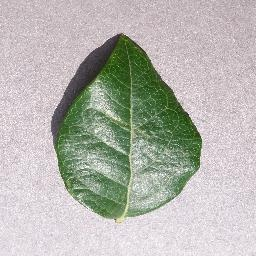

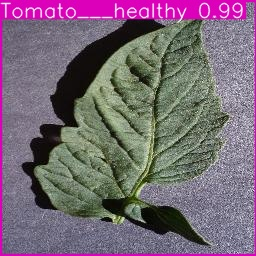

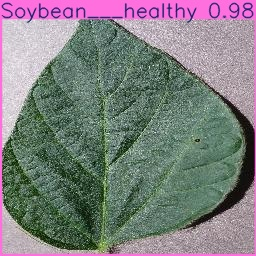

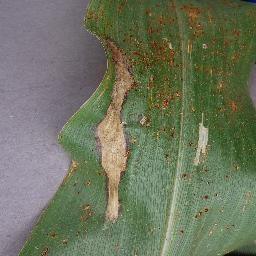

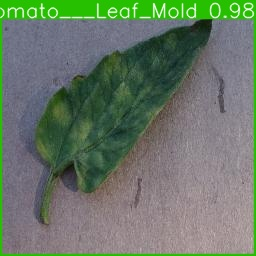

...

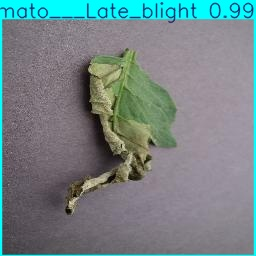

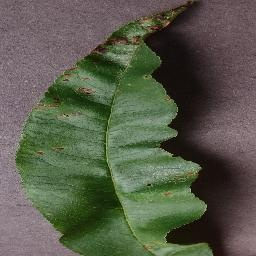

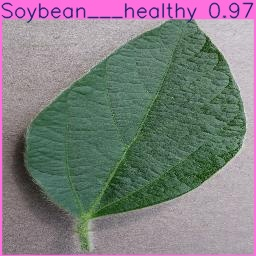

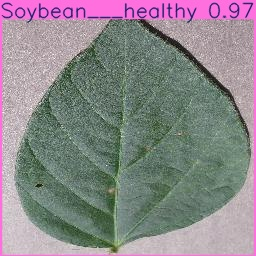

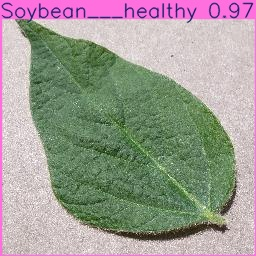

In [ ]:
import os
from IPython.display import Image, display

# Path to saved predictions
output_folder = "runs/detect/predict"

# Display images
for img_file in os.listdir(output_folder):
    if img_file.endswith(".jpg") or img_file.endswith(".png"):
        display(Image(filename=os.path.join(output_folder, img_file)))


In [ ]:
# Class-wise metrics
print("Class-wise metrics:")
for i, class_name in model.names.items():
    print(f"Class: {class_name}")
    # Access precision, recall, AP@50-95, and AP@50 using class_result method
    # Corrected indexing to ensure it stays within the bounds of the arrays
    # The loop now iterates until i - 1 is less than the length of metrics.box.p
    if i - 1 < len(metrics.box.p):
        p, r, ap50, ap = metrics.box.class_result(i - 1)
        print(f"  Precision: {p:.4f}")
        print(f"  Recall: {r:.4f}")
        print(f"  AP@50-95: {ap:.4f}")
        print(f"  AP@50: {ap50:.4f}")
    else:
        print(f"  Metrics not available for class index {i - 1}")

Class-wise metrics:
Class: Apple___Apple_scab
  Precision: 0.9858
  Recall: 0.9980
  AP@50-95: 0.9950
  AP@50: 0.9950
Class: Apple___Black_rot
  Precision: 0.9774
  Recall: 0.7742
  AP@50-95: 0.9407
  AP@50: 0.9407
Class: Apple___Cedar_apple_rust
  Precision: 0.0000
  Recall: 0.0000
  AP@50-95: 0.0000
  AP@50: 0.0000
Class: Apple___healthy
  Precision: 0.0000
  Recall: 0.0000
  AP@50-95: 0.0000
  AP@50: 0.0000
Class: Background_without_leaves
  Precision: 1.0000
  Recall: 0.0182
  AP@50-95: 0.9283
  AP@50: 0.9303
Class: Blueberry___healthy
  Precision: 0.5471
  Recall: 0.0288
  AP@50-95: 0.7390
  AP@50: 0.7442
Class: Cherry___healthy
  Precision: 1.0000
  Recall: 0.0000
  AP@50-95: 0.9282
  AP@50: 0.9282
Class: Cherry___Powdery_mildew
  Precision: 0.0000
  Recall: 0.0000
  AP@50-95: 0.0000
  AP@50: 0.0000
Class: Corn___Cercospora_leaf_spot Gray_leaf_spot
  Precision: 0.0000
  Recall: 0.0000
  AP@50-95: 0.0000
  AP@50: 0.0000
Class: Corn___Common_rust
  Precision: 0.0000
  Recall: 0.000

In [ ]:
# Overall performance metrics
print(f"Precision: {metrics.box.p.mean():.4f}")  # Calculate the mean precision
print(f"Recall: {metrics.box.r.mean():.4f}")      # Calculate the mean recall
print(f"F1 Score: {metrics.box.f1.mean():.4f}")    # Calculate the mean F1 score
print(f"mAP@50: {metrics.box.map50:.4f}")
print(f"mAP@50-95: {metrics.box.map:.4f}")

Precision: 0.7134
Recall: 0.5815
F1 Score: 0.5744
mAP@50: 0.7264
mAP@50-95: 0.7249


In [ ]:
from ultralytics import YOLO

# Load the trained model
model = YOLO('/content/data/runs/detect/train/weights/best.pt')

# Evaluate the model on a validation or test set
metrics = model.val()

# Print evaluation metrics
print(metrics)


Ultralytics 8.3.37 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,427,893 parameters, 0 gradients, 21.4 GFLOPs


val: Scanning /content/data/valid/labels.cache... 5317 images, 16 backgrounds, 0 corrupt: 100%|██████████| 5333/5333 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 334/334 [00:27<00:00, 11.95it/s]


                   all       5333       5317      0.713      0.582      0.726      0.725
    Apple___Apple_scab         62         62      0.977      0.774      0.941      0.941
     Apple___Black_rot         56         56          0          0          0          0
Apple___Cedar_apple_rust         15         15          0          0          0          0
       Apple___healthy        102        102          1     0.0182       0.93      0.928
   Blueberry___healthy        139        139      0.547     0.0288      0.744      0.739
      Cherry___healthy         88         88          1          0      0.928      0.928
Cherry___Powdery_mildew        106        106          0          0          0          0
Corn___Cercospora_leaf_spot Gray_leaf_spot         59         59          0          0          0          0
    Corn___Common_rust        115        115          0          0          0          0
        Corn___healthy        123        123          0          0          0          